In [45]:
import pandas as pd
import calmap
import matplotlib.pyplot as plt
from os import listdir, mkdir
from wordcloud import WordCloud, STOPWORDS

In [46]:
def readChatTxt(fileName):
    text = open(fileName, "r", encoding="utf8")
    chat = text.read()
    #put each message in a list
    #remove "/u200e" from the messages
    chat = chat.replace("\u200e", "")
    chatArray = chat.rsplit("\n[")
    return(chatArray)

In [47]:
def chatToDf(chatArray, title):
    cleanChatArray = []
    for message in chatArray:
        message = message.rstrip("\n")   
        message = message.lstrip("[")
        message = message.replace("]", "", 1)
        message = message.replace(", ", "-", 1)
        message = message.replace(" ", "-", 1)
        message = message.replace(": ", "-", 1)
        cleanChatArray.append(message)
    cleanChatArray.pop(0)
    cleanChatArray.pop(0)
    cleanChatArray.pop(0)
    #split each message into date, time, user and message
    finalArray = []
    for message in cleanChatArray:
        message = message.split("-", 3)
        finalArray.append(message)
    df = pd.DataFrame(finalArray, columns = ['Date', 'Time', 'User', 'Message'])
    df['DateTime'] = df['Date'] + " " + df['Time']
    df.drop(['Time'], axis=1, inplace=True)
    df = df[['Date','DateTime', 'User', 'Message']]
    #drop messages that say "This message was deleted."
    df.drop(df[df['Message'] == 'This message was deleted.'].index, inplace=True)

    df.dropna(inplace=True)
    df.drop(df[df['User'] == 'You'].index, inplace=True)
    #convert to datetime
    df['DateTime'] = pd.to_datetime(df['DateTime'], format='%d/%m/%Y %H:%M:%S')
    df['Date'] = pd.to_datetime(df['Date'], format='%d/%m/%Y')
    #add a column with frequency of messages that day
    df['Frequency'] = df.groupby('Date')['Date'].transform('count')

    #remove space after name
    df['User'] = df['User'].str.strip(" ")

    if(title not in listdir()):
        mkdir(title)
    df.to_csv(title + "/" + title + ".csv", index=False)
    return(df)

In [48]:
#create a dataframe for a specific user
def userDf(df, user, title):
    userDf = df[df['User'] == user]
    userDf = userDf[['Date', 'DateTime', 'User', 'Message', 'Frequency']]
    if(user not in listdir(title)):
        mkdir(title + "/" + user)
    userDf.to_csv(title + "/" + user + "/" + user + ".csv", index=False)
    return(userDf)

In [49]:
def countMessages(df):
    #count messages per user
    userCount = df.groupby('User')['User'].count()
    userCount = userCount.sort_values(ascending=False)
    userCount = userCount.to_frame()
    userCount = userCount.rename(columns={'User': 'Count'})
    return(userCount)

In [50]:
def convertToSeries(df):
    calDf = df[['Date', 'Frequency']]
    calDf = calDf.drop_duplicates()
    #convert to series
    calDf = calDf.set_index('Date')['Frequency']
    calDf
    return(calDf)


In [51]:
def plotYearActivity(series, chatYear, colourMap,lineColour,title, user):
    #plot the series
    plt.figure(figsize=(16,8))
    calmap.yearplot(series, year=chatYear, cmap=colourMap, fillcolor='grey', linewidth=0.5, linecolor=lineColour)
    #change title based on user or group
    if(user == "group"):
        plt.title(title + " Group Chat Activity " + str(chatYear), fontsize=20)
    else:
        #change title based on user
        plt.title(title + " Chat Activity " + str(chatYear) + " - " + user, fontsize=20)

In [52]:
def makeWordCloud(df, title, user):
    try:
        addStopWords = ['m','s','image','omitted','n','t','video','gif','https','http','sticker','audio','don'] + list(STOPWORDS)
    
        wordcloud = WordCloud(stopwords=addStopWords,width=1920, height=1080).generate(df['Message'].to_string())
        plt.figure(figsize=(16,8))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis("off")
        if(user == "group"):
            plt.title(title + " Group Chat Word Cloud", fontsize=20)
        else:
            #change title based on user
            plt.title(title + " Chat Word Cloud - " + user, fontsize=20)
    except:
        print("No messages to make word cloud")

In [53]:
def plotUserCount(userCount, title):
    #plot the user count
    plt.figure(figsize=(16,8))
    myCmap = plt.get_cmap('tab20')
    plt.bar(userCount.index, userCount['Count'], color=myCmap.colors)
    plt.title("Messages per User", fontsize=20)
    plt.xlabel("User", fontsize=16)
    #if there are too many users, rotate them
    if len(userCount.index) > 10:
        plt.xticks(rotation=30) 
    plt.ylabel("Messages", fontsize=16)

    

In [54]:
#save plotted figure and show it, changes if its just a user or the whole chat
def savePlot(title, user, plotType):
    if user == "":
        plt.savefig(title + "/" + title + ".png")
    else:
        plt.savefig(title + "/" + user + "/" + user + plotType + ".png")
    plt.show()

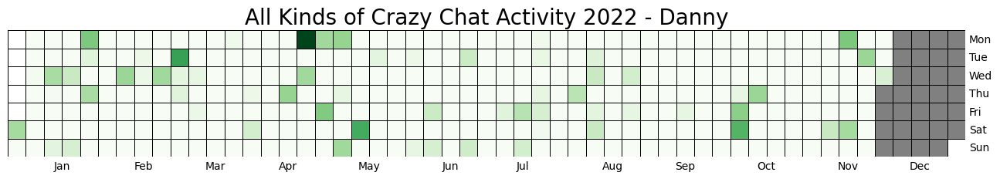

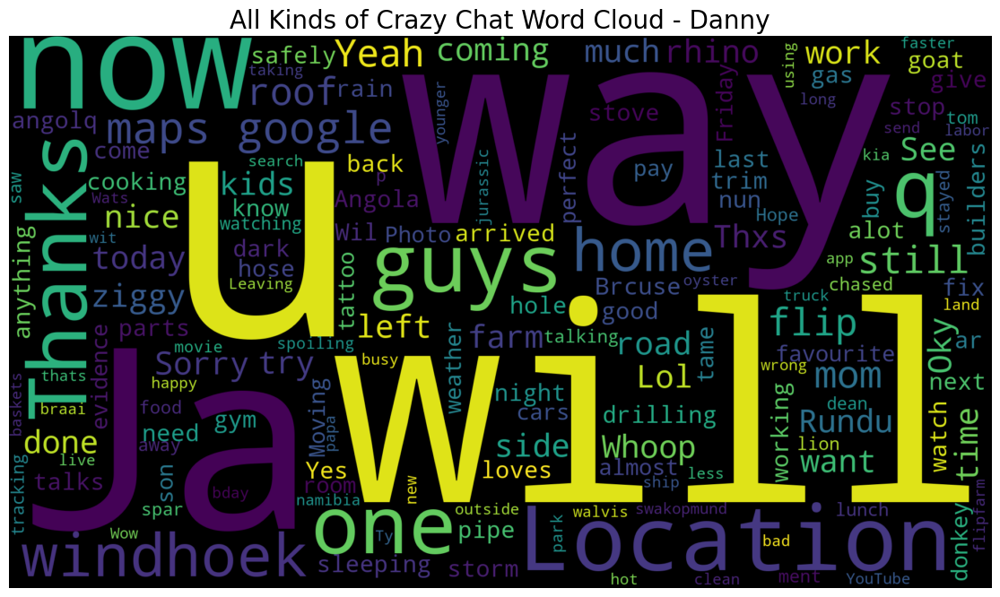

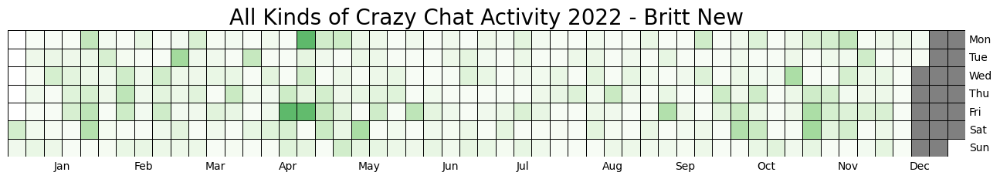

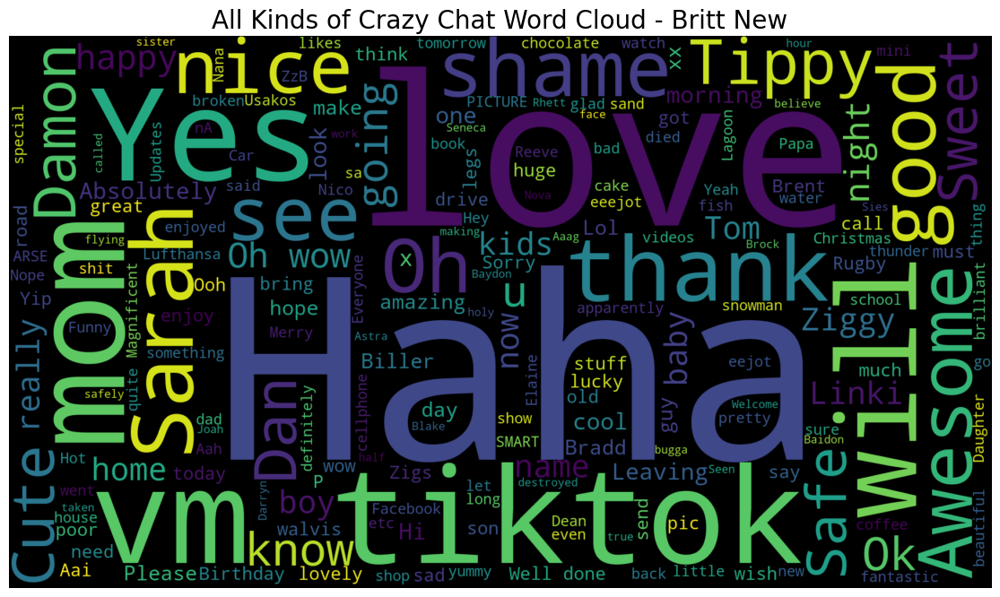

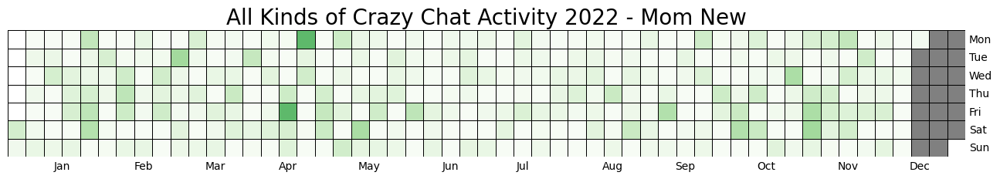

...

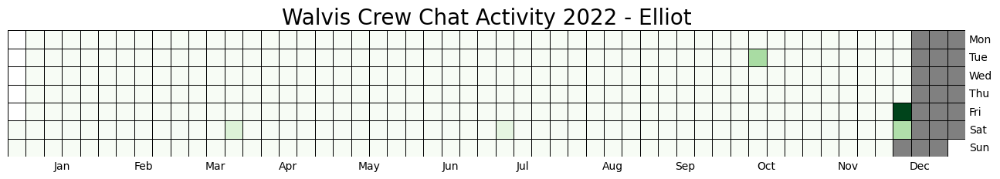

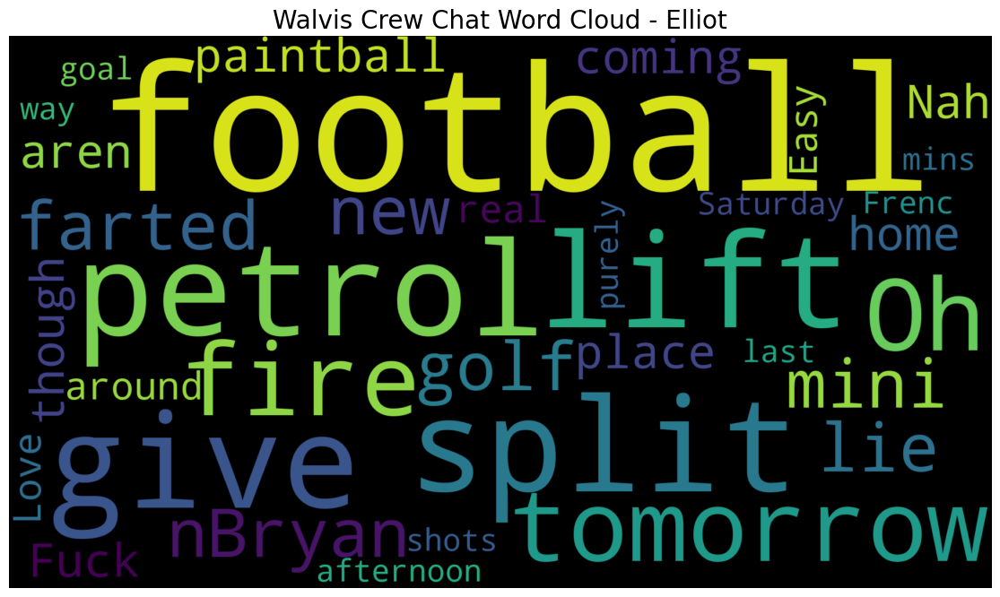

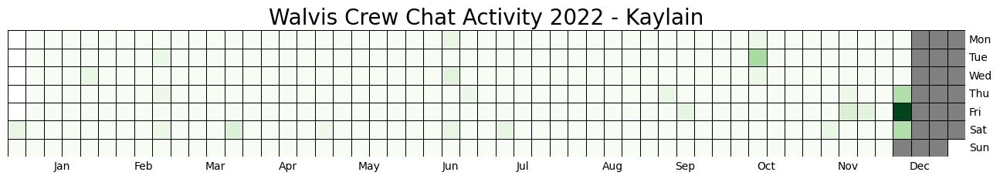

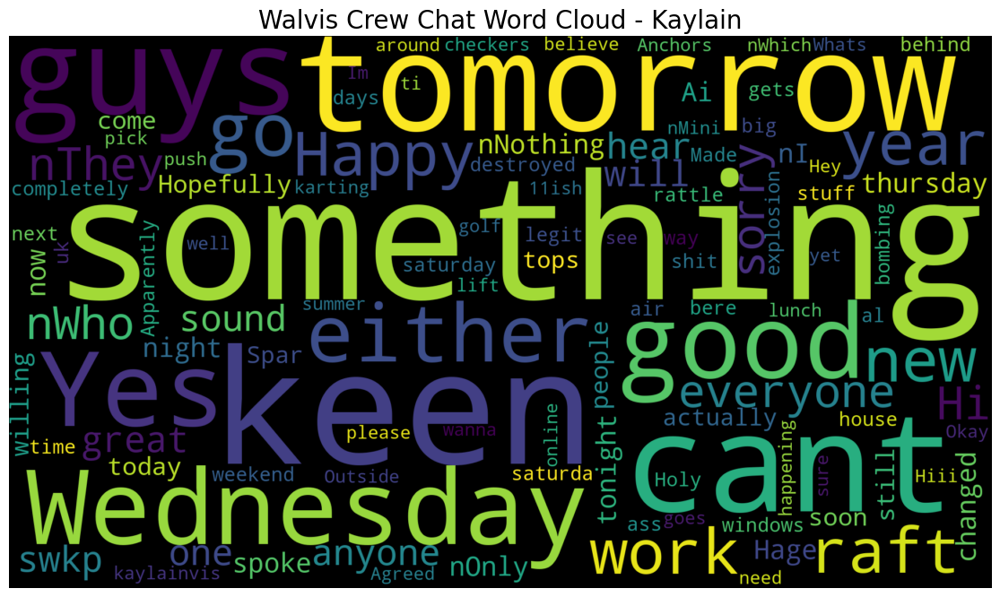

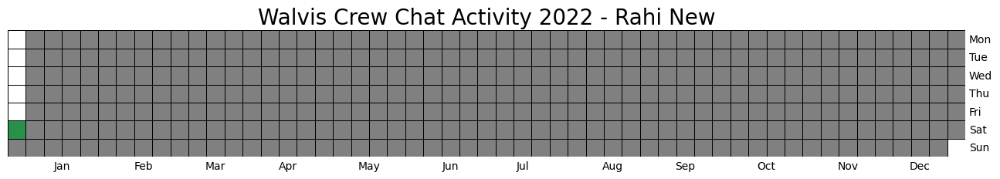

No messages to make word cloud


<Figure size 640x480 with 0 Axes>

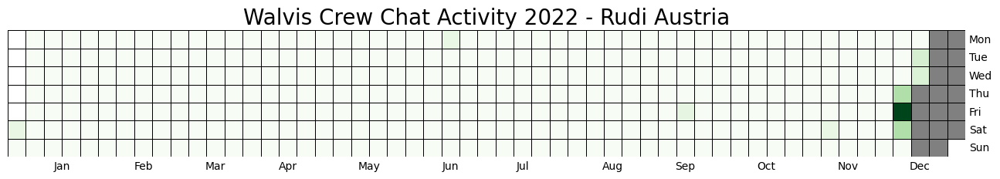

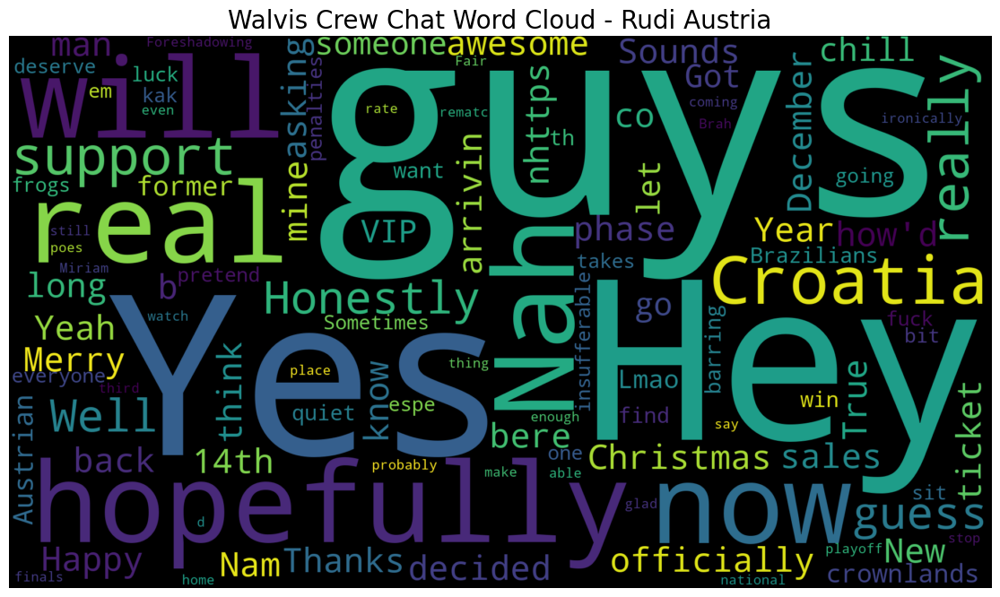

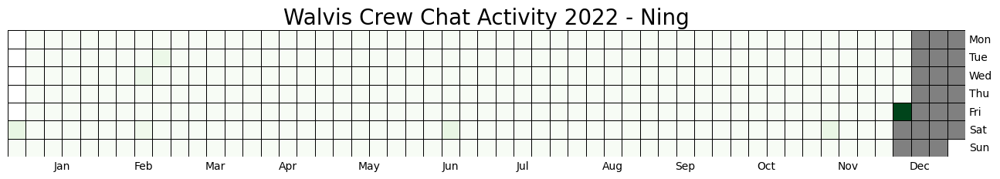

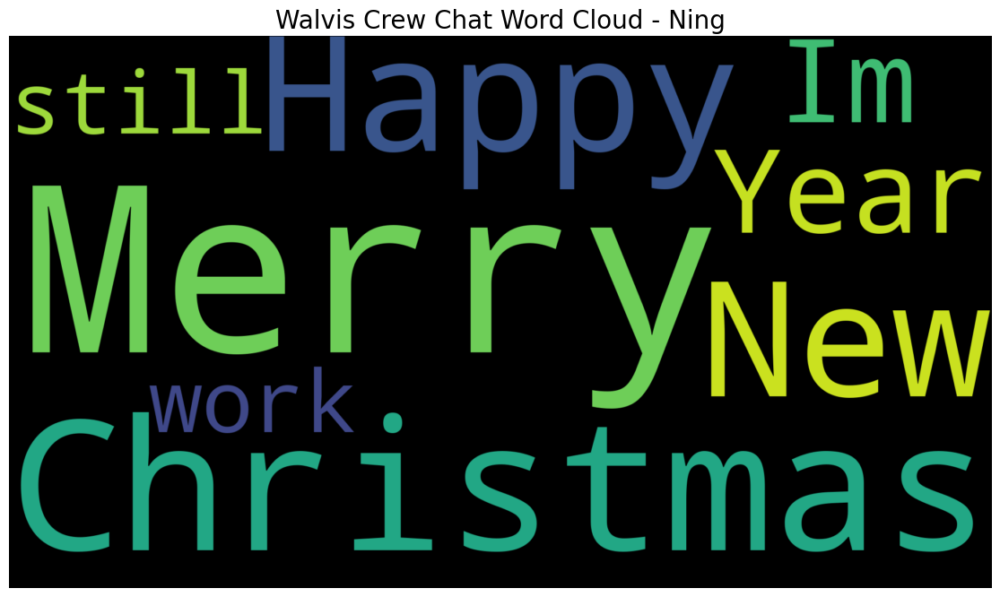

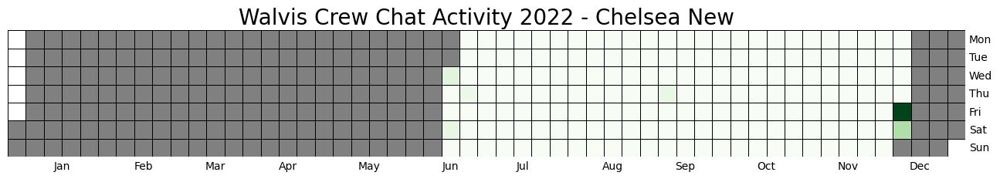

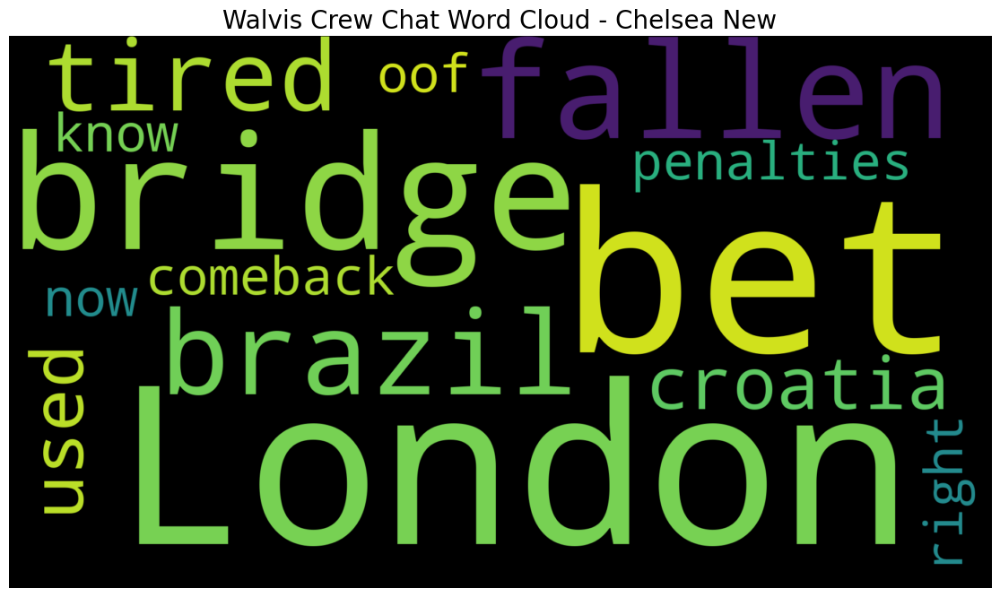

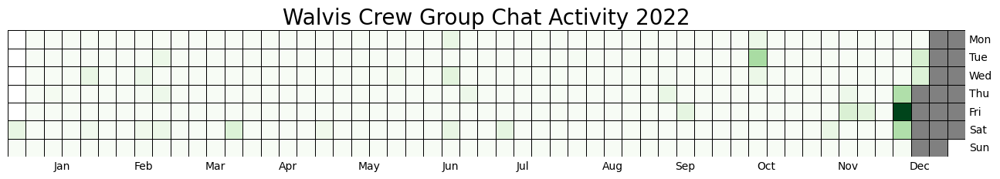

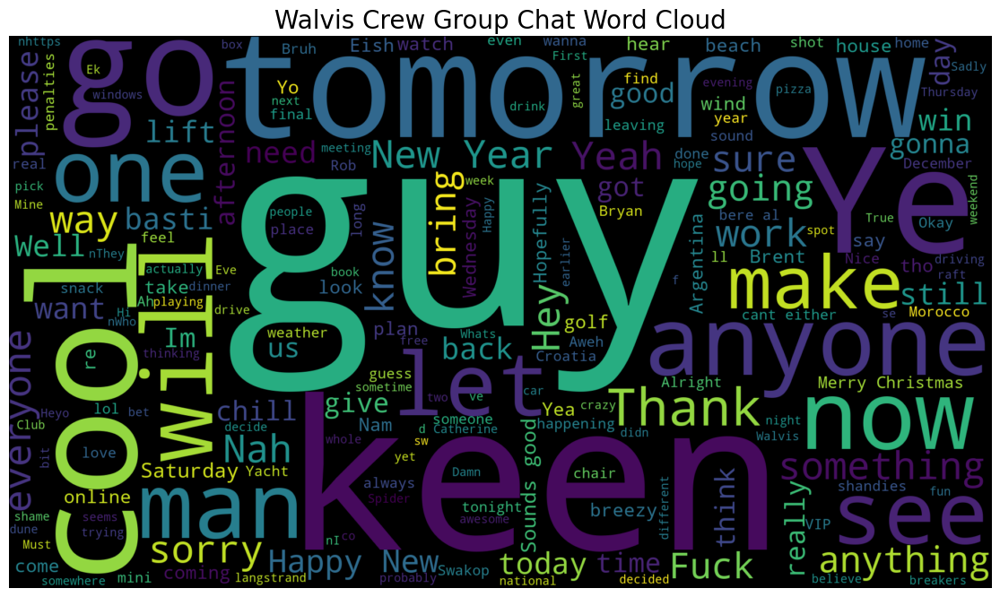

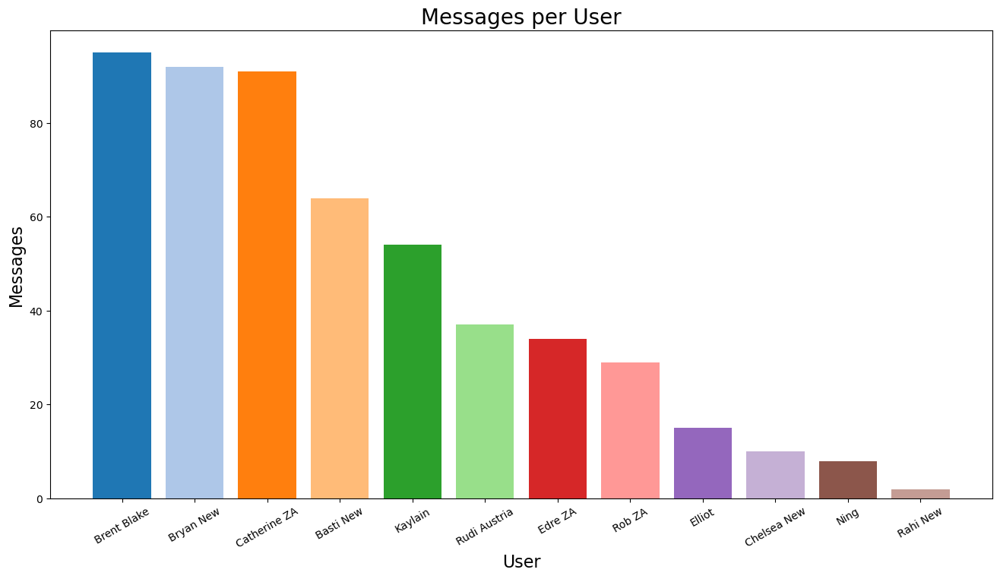

In [55]:
files = listdir(".")
for file in files:
    if file.endswith(".txt"):
        text = readChatTxt(file)
        file = file.replace(".txt", "")
        file = file.replace("_", " ")
        file = file.replace("chat", "")
        file = file.rstrip(" ")
        df = chatToDf(text, file)
        for user in df['User'].unique():
            messengerDf = userDf(df, user, file)
            messengerSeries = convertToSeries(messengerDf)
            plotYearActivity(messengerSeries, 2022, 'Greens', 'black', file, user)
            savePlot(file, user, "Year")
            makeWordCloud(messengerDf, file, user)
            savePlot(file, user, "WordCloud")
        series = convertToSeries(df)
        #get the amount of users in the df
        userCount = countMessages(df)
        plotYearActivity(series, 2022, 'Greens', 'black', file, "group")
        savePlot(file, "", "Year")
        makeWordCloud(df, file, "group")
        savePlot(file, "", "WordCloud")
        plotUserCount(userCount, file)
        savePlot(file, "", "UserCount")
        